In [36]:
import imageio_ffmpeg
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
from IPython.core.display import HTML
from matplotlib.animation import FuncAnimation
ffmpeg_path = imageio_ffmpeg.get_ffmpeg_exe()
plt.rcParams['animation.ffmpeg_path'] = ffmpeg_path
plt.rcParams['animation.embed_limit'] = 50  

In [30]:
#règles du modèle de base du système dynamique du jeu de la vie 
#- il existe deux états :
#      - 0 = cellule morte
#      - 1 = cellule vivante
#- une cellule vivante reste vivante si elle possède 2 ou 3 voisins vivants
#- une cellule vivante meurt si elle possède moins de 2 voisins vivants (sous‑population)
#- une cellule vivante meurt si elle possède plus de 3 voisins vivants (surpopulation)
#- une cellule morte devient vivante si elle possède exactement 3 voisins vivants (naissance)
#- toutes les mises à jour sont effectuées simultanément à chaque étape


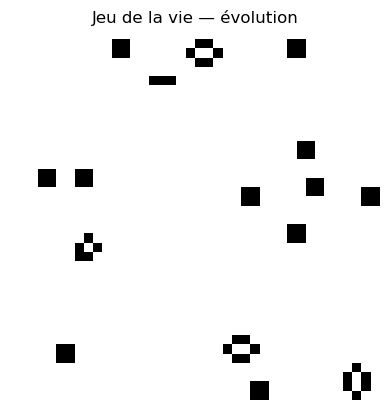

In [33]:
#modèle de base du système dynamique du jeu de la vie 

# j'initialise mon systeme
n = 40
m = 40
nb_iter = 100

# pour trouver le nombre de voisins vivants
def update(m, i, j):
    l = 0  # nombre de voisins vivants

    for a in range(i-1, i+2):
        for b in range(j-1, j+2):
            if 0 <= a < m.shape[0] and 0 <= b < m.shape[1]:
                if not (a == i and b == j):
                    if m[a, b] == 1:
                        l = l + 1
    return l

# à l'instant t
def statut(m):
    new_m = m.copy() 
    for i in range(m.shape[0]):
        for j in range(m.shape[1]):
            voisins = update(m, i, j)

            if m[i, j] == 1:
                if voisins == 2 or voisins == 3:
                    new_m[i, j] = 1
                else:
                    new_m[i, j] = 0
            else:
                if voisins == 3:
                    new_m[i, j] = 1
                else:
                    new_m[i, j] = 0

    return new_m

def animate(m, frames=200, interval=100):
    fig, ax = plt.subplots()
    img = ax.imshow(m, cmap="binary", interpolation="nearest")
    ax.set_title("Jeu de la vie — évolution")
    ax.axis("off")

    def update_frame(frame):
        nonlocal m
        m = statut(m)
        img.set_data(m)
        return [img]

    ani = animation.FuncAnimation(fig, update_frame, frames=frames, interval=interval, blit=True)
    return ani
sys = np.random.randint(0, 2, size=(n, m))
ani= animate(sys, frames=300, interval=80)
ani.save("regle_de_base.mp4", writer="ffmpeg")
HTML(ani.to_html5_video())

In [34]:
#variation 1 du modèle dynamique: energie interne des cellules  + l'nergie de l'environnement
#les règles:
#- chaque cellule vivante consomme une quantité fixe d’énergie interne à chaque étape
#- une cellule meurt si son énergie interne tombe à zéro ou en dessous
#- une cellule morte naît si elle possède exactement trois voisins vivants
#- une cellule vivante absorbe une partie de l’énergie du sol, jusqu’à un maximum par étape
#- l’énergie absorbée augmente l’énergie interne et diminue l’énergie environnementale locale
#- le sol se recharge naturellement d’une petite quantité d’énergie à chaque étape, jusqu’à un maximum fixé
#- si l’énergie interne totale dépasse l’énergie environnementale totale, un mécanisme de régulation supprime des cellules vivantes en priorité celles ayant le moins d’énergie interne
#- toutes les mises à jour (cellules, énergie interne, énergie du sol) sont effectuées simultanément à chaque étape

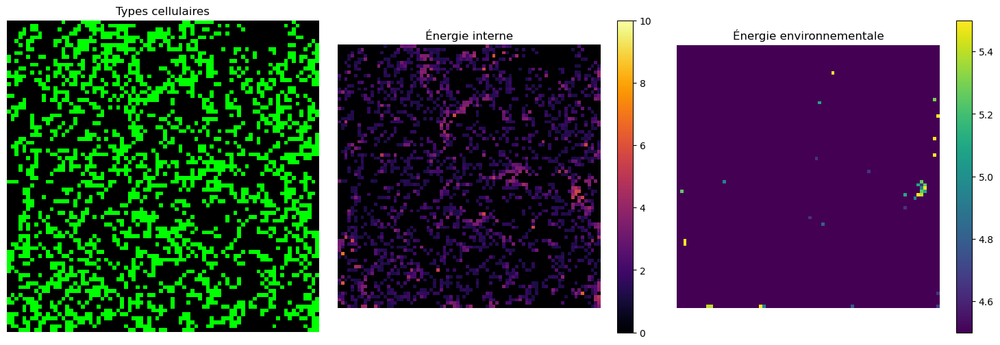

In [37]:
#variation 1 du modèle dynamique: energie interne des cellules  + l'nergie de l'environnement

#on initialise 3 grilles qui contiennent respectivement l'état des cellules ( 0 ou 1) puis l'energie aléatoire de chaque cellule associée(slm celles vivantes) et enfin l'énergie associée de la zone dans laquelle se trouve la cellule)
def initialisation2(n,m):
    gr1=np.random.randint(0,2,size=(n,m))
    gr2=np.zeros((n,m))
    gr3=5*np.ones((n,m))
    for i in range(n):
        for j in range(m):
            if gr1[i,j]==1:
                gr2[i,j]=np.random.randint(1,11)

    return gr1,gr2,gr3

def compter_voisins(m, i, j): # pour trouver le nombre de voisins vivants 
    n, p = m.shape
    voisins = 0
    for di in [-1, 0, 1]:
        for dj in [-1, 0, 1]:
            if di == 0 and dj == 0:
                continue
            ni = i + di
            nj = j + dj
            if 0 <= ni < n and 0 <= nj < p:
                voisins += m[ni, nj]
    return voisins

def regles(gr1, gr2, gr3):
    new_gr1 = gr1.copy()
    new_gr2 = gr2.copy()
    new_gr3 = gr3.copy()
    for i in range(gr1.shape[0]):
        for j in range(gr1.shape[1]):
            voisins = compter_voisins(gr1, i, j)

            # --- 1. Consommation d'énergie ---
            if gr1[i,j] == 1:
                new_gr2[i,j] -= 0.5

            # --- 2. Mort par manque d'énergie ---
            if new_gr1[i,j] == 1 and new_gr2[i,j] <= 0:
                new_gr1[i,j] = 0
                new_gr2[i,j] = 0

            # --- 3. Naissance ---
            if gr1[i,j] == 0 and voisins == 3:
                new_gr1[i,j] = 1
                new_gr2[i,j] = 1

            # --- 4. Absorption d'énergie ---
            if new_gr1[i,j] == 1:   # seulement si vivante
                absorption = min(new_gr3[i,j], 2.5)
                new_gr2[i,j] += absorption
                new_gr3[i,j] -= absorption

            # --- 5. Recharge du sol ---
            new_gr3[i,j] = min(new_gr3[i,j] + 0.15, 10)

    return new_gr1, new_gr2, new_gr3

def regulation(gr1, gr2, gr3):
    s1 = np.sum(gr2)
    s2 = np.sum(gr3)
    if s1 > s2:
        a = np.argsort(gr2.flatten())
        k = 0
        while s1 > s2 and k < len(a):
            i = a[k] // gr1.shape[1]
            j = a[k] %  gr1.shape[1]
            if gr1[i,j] == 1:
                s1 =s1-gr2[i,j]
                gr1[i,j] = 0
                gr2[i,j] = 0
            k += 1

    return gr1, gr2, gr3

def statut_energie(gr1, gr2, gr3):
    gr1, gr2, gr3 = regles(gr1, gr2, gr3)
    gr1, gr2, gr3 = regulation(gr1, gr2, gr3)
    return gr1, gr2, gr3

def animer_variante1(gr1, gr2, gr3, steps=300):

    fig, axes = plt.subplots(1, 3, figsize=(15, 5))

    # Graphe 1 : types cellulaires
    img1 = np.zeros((gr1.shape[0], gr1.shape[1], 3))
    im1 = axes[0].imshow(img1)
    axes[0].set_title("Types cellulaires")
    axes[0].axis('off')

    # Graphe 2 : énergie interne
    im2 = axes[1].imshow(gr2, cmap='inferno')
    axes[1].set_title("Énergie interne")
    axes[1].axis('off')
    fig.colorbar(im2, ax=axes[1])

    # Graphe 3 : énergie environnementale
    im3 = axes[2].imshow(gr3, cmap='viridis')
    axes[2].set_title("Énergie environnementale")
    axes[2].axis('off')
    fig.colorbar(im3, ax=axes[2])

    plt.tight_layout()

    def update_frame(frame):
        nonlocal gr1, gr2, gr3
        gr1, gr2, gr3 = statut_energie(gr1, gr2, gr3)

        # Mise à jour couleurs types cellulaires
        img = np.zeros((gr1.shape[0], gr1.shape[1], 3))
        img[gr1 == 1] = [0, 1, 0]   # normal = vert
        im1.set_data(img)

        # Mise à jour énergies
        im2.set_data(gr2)
        im3.set_data(gr3)

        return [im1, im2, im3]

    ani = FuncAnimation(fig, update_frame, frames=steps, interval=50)
    return ani

gr1, gr2, gr3 = initialisation2(80, 80)
ani = animer_variante1(gr1, gr2, gr3, steps=500)
ani.save("regles_avec_energies.mp4", writer="ffmpeg")
HTML(ani.to_html5_video())

In [38]:
# règles de la variation 2 du modèle dynamique: tumeur

#- la grille contient des cellules normales (1), tumorales (2) et des cases vides (0)
#- une cellule normale peut devenir tumorale si elle possède au moins deux voisins tumoraux
#- la probabilité ou vitesse de contamination dépend d’un paramètre de propagation
#- une cellule tumorale reste tumorale définitivement (pas de guérison)
#- une cellule normale peut naître dans une case vide si elle possède exactement trois voisins vivants et aucun voisin tumoral (règle classique du Game of Life)
#- une cellule normale sans voisin tumoral reste normale
#- les cases vides sans conditions de naissance restent vides
#- toutes les mises à jour (contamination, naissance, maintien des états) sont effectuées simultanément à chaque étape
#- une cellule tumorale meurent si tous ses voisins sont aussi tumoraux 


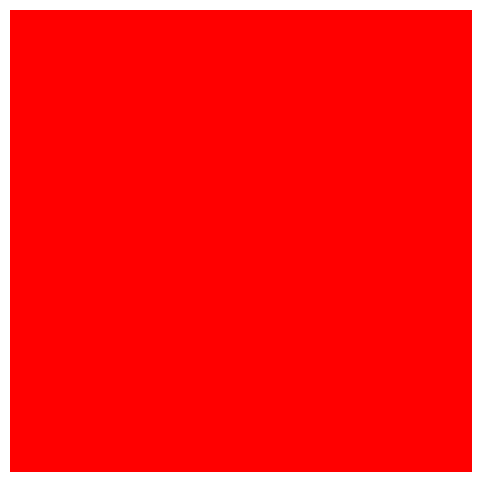

In [39]:
#variation 2 du modèle dynamique: tumeur

def initialisation3(n, m):
    gr = np.zeros((n, m))
    # création des cellules normales(1) et vides(0) aléatoires
    mask = np.random.rand(n, m) < 0.1
    gr[mask] = 1

    # création du noyau tumoral au centre
    cx, cy = n // 2, m // 2
    r = 3
    for i in range(cx - r, cx + r + 1):
        for j in range(cy - r, cy + r + 1):
            if 0 <= i < n and 0 <= j < m:
                gr[i, j] = 2

    return gr

def matrice_voisins(gr, i, j): # retourne la matrice carrée des voisins de la cellule gr[i,j]
    n, m = gr.shape
    voisins = gr[max(0, i-1):min(n, i+2), max(0, j-1):min(m, j+2)]
    return voisins

def regles_tumeur(gr, vitesse_tumeur=0.5):
    n, m = gr.shape
    new = gr.copy()

    for i in range(n):
        for j in range(m):
            voisins = matrice_voisins(gr, i, j)
            voisins_norm = np.sum(voisins == 1)
            voisins_tum = np.sum(voisins == 2)
            voisins_vides = np.sum(voisins == 0)

            # --- 1. Propagation tumorale contrôlée ---
            if gr[i, j] == 0 and voisins_tum >= 1:
                if np.random.rand() < vitesse_tumeur:
                    new[i, j] = 2

            # --- 2. Invasion tumorale ---
            if gr[i, j] == 1 and voisins_tum >= 2:
                new[i, j] = 2

            # --- 3. Nécrose (centre de tumeur) ---
            if gr[i, j] == 2 and voisins_tum == 8 and voisins_vides == 0:
                new[i, j] = 0

            # --- 4. Naissance normale (optionnelle) ---
            if gr[i, j] == 0 and voisins_norm == 3 and voisins_tum == 0:
                new[i, j] = 1

    return new

def animer_tumeur(gr, steps=700, vitesse_tumeur=0.5):

    fig, ax = plt.subplots(figsize=(6, 6))

    # image initiale
    img = np.zeros((gr.shape[0], gr.shape[1], 3))
    im = ax.imshow(img)
    ax.axis('off')

    def update_frame(frame):
        nonlocal gr
        gr = regles_tumeur(gr, vitesse_tumeur)

        # mise à jour des couleurs
        img = np.zeros((gr.shape[0], gr.shape[1], 3))
        img[gr == 1] = [0, 1, 0]   # normal = vert
        img[gr == 2] = [1, 0, 0]   # tumoral = rouge

        im.set_data(img)
        return [im]

    ani = FuncAnimation(fig, update_frame, frames=steps, interval=150)
    return ani

gr = initialisation3(80, 80)

ani = animer_tumeur(gr, steps=500, vitesse_tumeur=0.3)
ani.save("regles_tumeur.mp4", writer="ffmpeg")
HTML(ani.to_html5_video())    